<a href="https://colab.research.google.com/github/4lparslan/HousingPricePrediction_ML_Bootcamp/blob/main/Housing_Price_Prediction-test1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1- Importing the required libraries

In [1]:
# Import Pandas, NumPy, Seaborn and Matplotlib
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Import Label Encoder and train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split, cross_validate

# Import Models
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.linear_model import ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import AdaBoostRegressor

# Evaluation metrics
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, make_scorer

# Other
import os
from numpy import sqrt

# 2- Importing Dataset

**NOTE: First, insert your api key as kaggle.json**

In [2]:
! pip install kaggle

In [3]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json


In [4]:
! kaggle datasets download -d anthonypino/melbourne-housing-market
!unzip melbourne-housing-market.zip -d melbourne-housing-market
os.remove("melbourne-housing-market.zip")

  0% 0.00/2.28M [00:00<?, ?B/s]
100% 2.28M/2.28M [00:00<00:00, 182MB/s]
Archive:  melbourne-housing-market.zip
  inflating: melbourne-housing-market/MELBOURNE_HOUSE_PRICES_LESS.csv  
  inflating: melbourne-housing-market/Melbourne_housing_FULL.csv  


In [5]:
dataset = pd.read_csv("melbourne-housing-market/Melbourne_housing_FULL.csv")
dataset2 = pd.read_csv("melbourne-housing-market/MELBOURNE_HOUSE_PRICES_LESS.csv")

In [6]:
dataset.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [7]:
dataset2.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Postcode,Regionname,Propertycount,Distance,CouncilArea
0,Abbotsford,49 Lithgow St,3,h,1490000.0,S,Jellis,1/04/2017,3067,Northern Metropolitan,4019,3.0,Yarra City Council
1,Abbotsford,59A Turner St,3,h,1220000.0,S,Marshall,1/04/2017,3067,Northern Metropolitan,4019,3.0,Yarra City Council
2,Abbotsford,119B Yarra St,3,h,1420000.0,S,Nelson,1/04/2017,3067,Northern Metropolitan,4019,3.0,Yarra City Council
3,Aberfeldie,68 Vida St,3,h,1515000.0,S,Barry,1/04/2017,3040,Western Metropolitan,1543,7.5,Moonee Valley City Council
4,Airport West,92 Clydesdale Rd,2,h,670000.0,S,Nelson,1/04/2017,3042,Western Metropolitan,3464,10.4,Moonee Valley City Council


**Let's find difference between two dataset.**

In [8]:
diff_col = set(dataset.columns) ^ set(dataset2.columns)

# Sonuçları görüntüle
print("Different column names: ", diff_col)


Different column names:  {'Car', 'Landsize', 'BuildingArea', 'Bathroom', 'Lattitude', 'Longtitude', 'Bedroom2', 'YearBuilt'}


**We will use the full version of dataset.**

In [9]:
# Lets create a copy of original dataset in case comparison is needed
dataset_original = dataset.copy()

# 3- Get to Know About the Dataset


In [10]:
dataset.columns

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'SellerG',
       'Date', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount'],
      dtype='object')

In [11]:
dataset.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [12]:
dataset.tail()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,...,1.0,3.0,593.0,NaN,NaN,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,...,2.0,1.0,98.0,104.0,2018.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,...,1.0,2.0,220.0,120.0,2000.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0
34855,Yarraville,12/37 Stephen St,3,h,1140000.0,SP,hockingstuart,24/02/2018,6.3,3013.0,...,NaN,NaN,NaN,NaN,NaN,Maribyrnong City Council,NaN,NaN,Western Metropolitan,6543.0
34856,Yarraville,3 Tarrengower St,2,h,1020000.0,PI,RW,24/02/2018,6.3,3013.0,...,1.0,0.0,250.0,103.0,1930.0,Maribyrnong City Council,-37.81810,144.89351,Western Metropolitan,6543.0


**We need to see all the columns to check our dataset need preprocessing or not.**



In [13]:
# To show all columns and all rows:
#pd.set_option('display.max_columns', None, 'display.max_rows', None):

# Just show all the columns:
pd.set_option('display.max_columns', None)
dataset

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,2.0,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.80140,144.99580,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,2.0,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.79960,144.99840,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,2.0,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.80790,144.99340,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,3.0,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.81140,145.01160,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,3.0,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.80930,144.99440,Northern Metropolitan,4019.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,4.0,1.0,3.0,593.0,NaN,NaN,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,2.0,2.0,1.0,98.0,104.0,2018.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,2.0,1.0,2.0,220.0,120.0,2000.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0
34855,Yarraville,12/37 Stephen St,3,h,1140000.0,SP,hockingstuart,24/02/2018,6.3,3013.0,NaN,NaN,NaN,NaN,NaN,NaN,Maribyrnong City Council,NaN,NaN,Western Metropolitan,6543.0


# 4- Exploratory Data Analysis (EDA)

In [14]:
# We can see that there are lots of missing value.
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         34857 non-null  object 
 1   Address        34857 non-null  object 
 2   Rooms          34857 non-null  int64  
 3   Type           34857 non-null  object 
 4   Price          27247 non-null  float64
 5   Method         34857 non-null  object 
 6   SellerG        34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom2       26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   13742 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

In [15]:
print(f'Shape:        {dataset.shape}\n'
      f'Size:         {dataset.size}\n'
      f'Dimension:    {dataset.ndim}\n')

Shape:        (34857, 21)
Size:         731997
Dimension:    2



In [16]:
dataset.isnull().sum()

Suburb               0
Address              0
Rooms                0
Type                 0
Price             7610
Method               0
SellerG              0
Date                 0
Distance             1
Postcode             1
Bedroom2          8217
Bathroom          8226
Car               8728
Landsize         11810
BuildingArea     21115
YearBuilt        19306
CouncilArea          3
Lattitude         7976
Longtitude        7976
Regionname           3
Propertycount        3
dtype: int64

**T**

In [17]:
dataset.duplicated().sum()

1

In [18]:
dataset.loc[dataset.duplicated(keep=False), :]

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
15857,Nunawading,1/7 Lilian St,3,t,NaN,SP,Jellis,17/06/2017,15.4,3131.0,3.0,3.0,2.0,405.0,226.0,2000.0,Manningham City Council,-37.82678,145.16777,Eastern Metropolitan,4973.0
15858,Nunawading,1/7 Lilian St,3,t,NaN,SP,Jellis,17/06/2017,15.4,3131.0,3.0,3.0,2.0,405.0,226.0,2000.0,Manningham City Council,-37.82678,145.16777,Eastern Metropolitan,4973.0


In [19]:
dataset = dataset.drop_duplicates()


In [20]:
dataset.duplicated().sum()

0

In [21]:
# Arrange output format of describe()
pd.set_option('display.float_format', '{:.2f}'.format)

dataset.describe().T

# As we can see;
## rooms max, distance max, bedroom max, bathroom max, car max, landsize max, buildingArea max, propertyCount min-max values are may be outliers.

,count,mean,std,min,25%,50%,75%,max
Rooms,34856.00,3.03,0.97,1.00,2.00,3.00,4.00,16.00
Price,27247.00,1050173.34,641467.13,85000.00,635000.00,870000.00,1295000.00,11200000.00
Distance,34855.00,11.18,6.79,0.00,6.40,10.30,14.00,48.10
Postcode,34855.00,3116.06,109.03,3000.00,3051.00,3103.00,3156.00,3978.00
Bedroom2,26639.00,3.08,0.98,0.00,2.00,3.00,4.00,30.00
Bathroom,26630.00,1.62,0.72,0.00,1.00,2.00,2.00,12.00
Car,26128.00,1.73,1.01,0.00,1.00,2.00,2.00,26.00
Landsize,23046.00,593.61,3398.92,0.00,224.00,521.00,670.00,433014.00
BuildingArea,13741.00,160.25,401.28,0.00,102.00,136.00,188.00,44515.00
YearBuilt,15550.00,1965.29,37.33,1196.00,1940.00,1970.00,2000.00,2106.00


In [22]:
dataset.nunique()

Suburb             351
Address          34009
Rooms               12
Type                 3
Price             2871
Method               9
SellerG            388
Date                78
Distance           215
Postcode           211
Bedroom2            15
Bathroom            11
Car                 15
Landsize          1684
BuildingArea       740
YearBuilt          160
CouncilArea         33
Lattitude        13402
Longtitude       14524
Regionname           8
Propertycount      342
dtype: int64

<ipython-input-23-87aeff76345a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = dataset.corr()


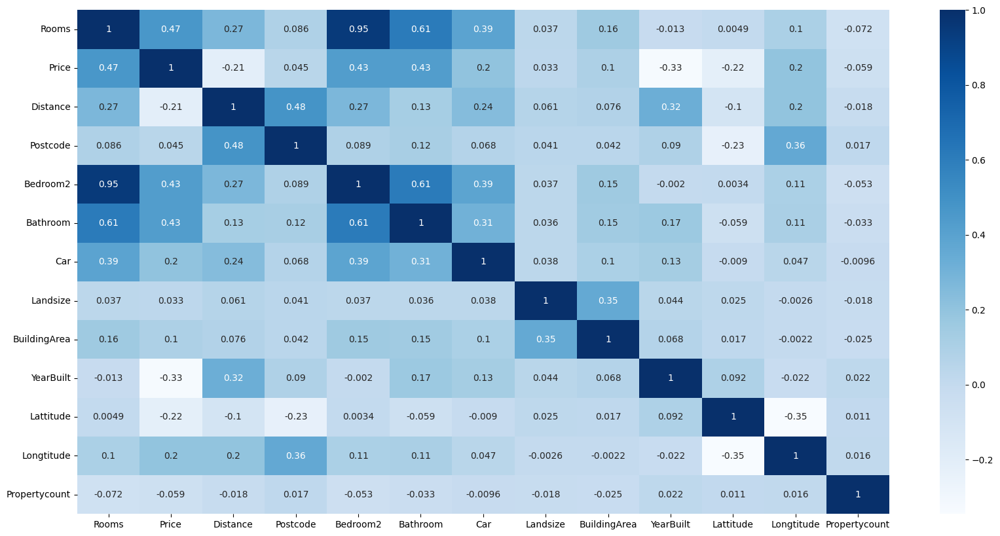

In [23]:
corr = dataset.corr()
plt.figure(figsize=(20,10))
sns.heatmap(corr, cmap="Blues", annot=True);

**We should remove 'Bedroom' and 'Bathroom' feature because of high correlation.**

In [24]:
dataset = dataset.drop(["Bedroom2", "Bathroom"], axis=1)

# 5- Feature Engineering

##5.1- Missing Values

In [25]:
print(
    pd.concat([dataset.isnull().sum(), dataset.isnull().sum()/len(dataset)*100],
              keys=["Number of Missing Values", "Ratio of Missing Values"],
              axis=1
              )
)

               Number of Missing Values  Ratio of Missing Values
Suburb                                0                     0.00
Address                               0                     0.00
Rooms                                 0                     0.00
Type                                  0                     0.00
Price                              7609                    21.83
Method                                0                     0.00
SellerG                               0                     0.00
Date                                  0                     0.00
Distance                              1                     0.00
Postcode                              1                     0.00
Car                                8728                    25.04
Landsize                          11810                    33.88
BuildingArea                      21115                    60.58
YearBuilt                         19306                    55.39
CouncilArea              

**We should remove "Car", "Landsize", "BuildingArea", "YearBuilt", "Lattitude" and "Longtitude" features because of high ratio of missing values.**

In [26]:
dataset = dataset.drop(["Car", "Landsize", "BuildingArea", "YearBuilt", "Lattitude", "Longtitude"], axis=1)

**We will remove rows with missing values : 'Price', 'Propertcount', 'Regionname', 'Distance', 'Postcode' and 'CouncilArea'**

In [27]:
# Specifying the rows with missing values.
rows_with_null_values = dataset[dataset.isnull().any(axis=1)]

rows_with_null_values

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,CouncilArea,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
7,Abbotsford,16 Maugie St,4,h,NaN,SN,Nelson,6/08/2016,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
8,Abbotsford,53 Turner St,2,h,NaN,S,Biggin,6/08/2016,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
9,Abbotsford,99 Turner St,2,h,NaN,S,Collins,6/08/2016,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
34829,West Melbourne,9/11 Anderson St,3,u,NaN,S,hockingstuart,24/02/2018,3.10,3003.00,Melbourne City Council,Northern Metropolitan,2230.00
34834,Wheelers Hill,112 Jells Rd,4,h,NaN,PN,Harcourts,24/02/2018,16.70,3150.00,Monash City Council,South-Eastern Metropolitan,7392.00
34835,Wheelers Hill,20 Mill Ct,3,h,NaN,S,Barry,24/02/2018,16.70,3150.00,Monash City Council,South-Eastern Metropolitan,7392.00
34845,Windsor,13 Mary St,4,h,NaN,W,Jellis,24/02/2018,4.60,3181.00,Port Phillip City Council,Southern Metropolitan,4380.00


In [28]:
# Get indexes
rows_to_drop = dataset[dataset.isnull().any(axis=1)].index


# Delete specified rows from the dataset
dataset = dataset.drop(rows_to_drop)

**As you see below, there are outlier values in 'Price' column. First we will eliminate the outliers. After that we will use mean values for filling.**

In [29]:
dataset.describe().T

,count,mean,std,min,25%,50%,75%,max
Rooms,27244.00,2.99,0.95,1.00,2.00,3.00,4.00,16.00
Price,27244.00,1050210.03,641492.29,85000.00,635000.00,870000.00,1295000.00,11200000.00
Distance,27244.00,11.28,6.79,0.00,6.40,10.50,14.00,48.10
Postcode,27244.00,3113.80,111.14,3000.00,3046.00,3088.00,3153.00,3978.00
Propertycount,27244.00,7566.78,4492.38,83.00,4294.00,6567.00,10412.00,21650.00


##5.2- Outlier Detection and Handling

In [30]:
def outlier_thresholds(df, col_name, low_quantile=0.30, up_quantile=0.70):
    Q1 = df[col_name].quantile(low_quantile)
    Q3 = df[col_name].quantile(up_quantile)
    IQR = Q3 - Q1
    low_limit = Q1 - 1.5 * IQR
    up_limit = Q3 + 1.5 * IQR
    print(col_name, low_limit, up_limit)
    return low_limit, up_limit

In [31]:
def check_outlier(dataframe, col_name):
    low_limit, up_limit = outlier_thresholds(dataframe, col_name)
    if dataframe[(dataframe[col_name] > up_limit) | (dataframe[col_name] < low_limit)].any(axis=None):
        return True
    else:
        return False



In [32]:
# Specifying numeric columns
num_cols = ['Price', 'Propertycount']

In [33]:
for col in num_cols:
    print(col, check_outlier(dataset, col))

Price -105000.0 1983000.0
Price True
Propertycount -1393.5 15218.5
Propertycount True


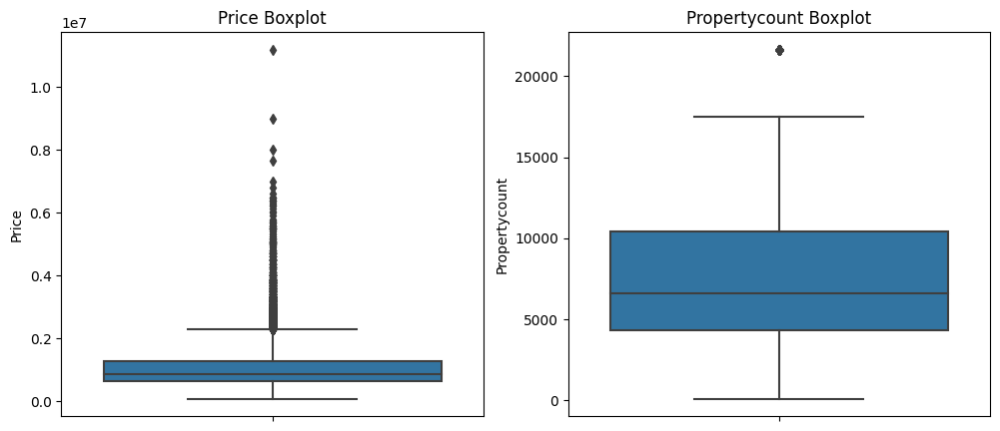

In [34]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.boxplot(y="Price", data=dataset)
plt.title("Price Boxplot");

plt.subplot(1, 2, 2)
sns.boxplot(y="Propertycount", data=dataset)
plt.title("Propertycount Boxplot");

In [35]:
# Outlier supression function
def replace_with_thresholds(dataframe, variable):
    low_limit, up_limit = outlier_thresholds(dataframe, variable)
    dataframe.loc[(dataframe[variable] < low_limit), variable] = low_limit
    dataframe.loc[(dataframe[variable] > up_limit), variable] = up_limit

In [36]:
for col in num_cols:
    print(col, replace_with_thresholds(dataset, col))

Price -105000.0 1983000.0
Price None
Propertycount -1393.5 15218.5
Propertycount None


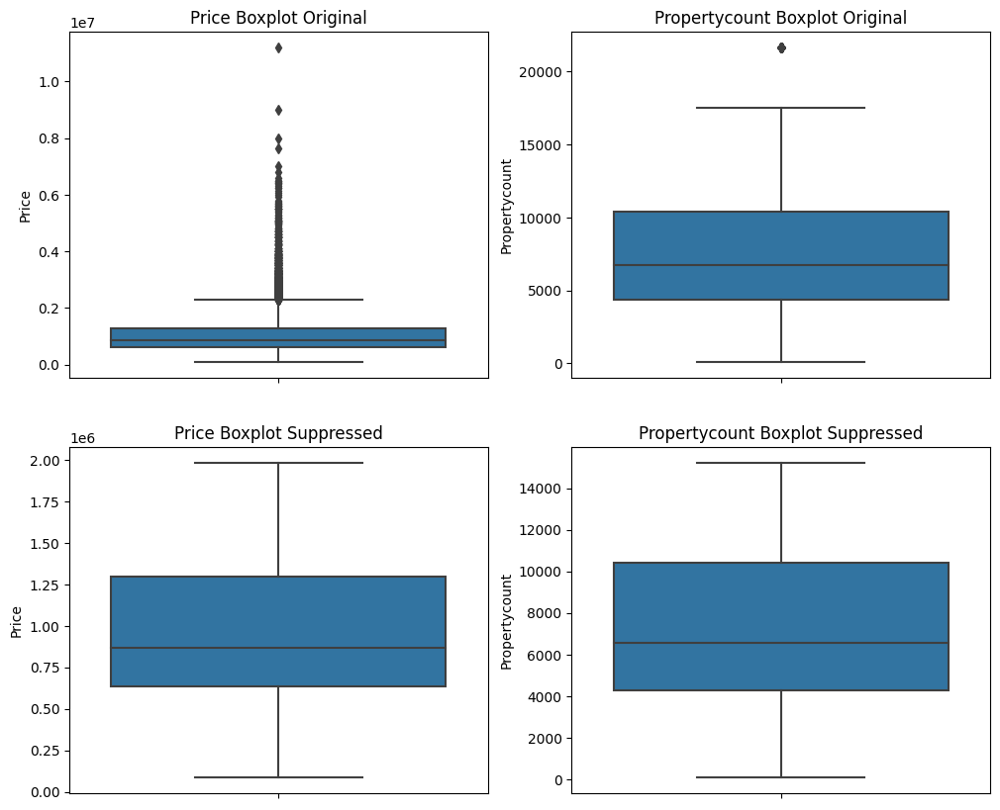

In [37]:
plt.figure(figsize=(12, 10))

plt.subplot(2, 2, 1)
sns.boxplot(y="Price", data=dataset_original)
plt.title("Price Boxplot Original");

plt.subplot(2, 2, 2)
sns.boxplot(y="Propertycount", data=dataset_original)
plt.title("Propertycount Boxplot Original");

plt.subplot(2, 2, 3)
sns.boxplot(y="Price", data=dataset)
plt.title("Price Boxplot Suppressed");

plt.subplot(2, 2, 4)
sns.boxplot(y="Propertycount", data=dataset)
plt.title("Propertycount Boxplot Suppressed");



##5.3- Encoding and Scaling

In [38]:
dataset.nunique()

Suburb             344
Address          26748
Rooms               12
Type                 3
Price             2353
Method               5
SellerG            349
Date                78
Distance           213
Postcode           209
CouncilArea         33
Regionname           8
Propertycount      328
dtype: int64

**As we see in the dataset below, encoding needed for Suburb, Address, Type, Method, SellerG, Date, CouncilArea and Regionname**
<br>
**PROCESSES:**
<br>
**Label Encoding (Less unique values): Type, Method, Regionname**
<br>
**One Hot Encoding (Lots of unique values): Suburb, Address, SellerG, Date, CouncilArea**



In [39]:
dataset

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,CouncilArea,Regionname,Propertycount
1,Abbotsford,85 Turner St,2,h,1480000.00,S,Biggin,3/12/2016,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
2,Abbotsford,25 Bloomburg St,2,h,1035000.00,S,Biggin,4/02/2016,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
4,Abbotsford,5 Charles St,3,h,1465000.00,SP,Biggin,4/03/2017,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
5,Abbotsford,40 Federation La,3,h,850000.00,PI,Biggin,4/03/2017,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
6,Abbotsford,55a Park St,4,h,1600000.00,VB,Nelson,4/06/2016,2.50,3067.00,Yarra City Council,Northern Metropolitan,4019.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
34852,Yarraville,13 Burns St,4,h,1480000.00,PI,Jas,24/02/2018,6.30,3013.00,Maribyrnong City Council,Western Metropolitan,6543.00
34853,Yarraville,29A Murray St,2,h,888000.00,SP,Sweeney,24/02/2018,6.30,3013.00,Maribyrnong City Council,Western Metropolitan,6543.00
34854,Yarraville,147A Severn St,2,t,705000.00,S,Jas,24/02/2018,6.30,3013.00,Maribyrnong City Council,Western Metropolitan,6543.00
34855,Yarraville,12/37 Stephen St,3,h,1140000.00,SP,hockingstuart,24/02/2018,6.30,3013.00,Maribyrnong City Council,Western Metropolitan,6543.00


In [40]:
# Classifynig columns
columns_for_label_enc = ['Type', 'Method', 'Regionname']
columns_for_one_hot_enc = ['Suburb', 'Address', 'SellerG', 'Date', 'CouncilArea']
num_col = ['Propertycount', 'Postcode', 'Distance', 'Price', 'Rooms']

In [41]:
# Label Encoding
label_encoders = {}

for column in columns_for_label_enc:
  label_encoders[column] = LabelEncoder()
  dataset[column] = label_encoders[column].fit_transform(dataset[column])

In [42]:
# Label Encoding2
label_encoders = {}

for column in columns_for_one_hot_enc:
  label_encoders[column] = LabelEncoder()
  dataset[column] = label_encoders[column].fit_transform(dataset[column])

In [43]:
dataset

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,CouncilArea,Regionname,Propertycount
1,0,25614,2,0,1480000.00,1,32,60,2.50,3067.00,31,2,4019.00
2,0,12159,2,0,1035000.00,1,32,63,2.50,3067.00,31,2,4019.00
4,0,19854,3,0,1465000.00,3,32,64,2.50,3067.00,31,2,4019.00
5,0,18368,3,0,850000.00,0,32,64,2.50,3067.00,31,2,4019.00
6,0,21396,4,0,1600000.00,4,206,65,2.50,3067.00,31,2,4019.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
34852,341,4639,4,0,1480000.00,0,140,38,6.30,3013.00,16,6,6543.00
34853,341,13424,2,0,888000.00,3,290,38,6.30,3013.00,16,6,6543.00
34854,341,5787,2,1,705000.00,1,140,38,6.30,3013.00,16,6,6543.00
34855,341,4290,3,0,1140000.00,3,334,38,6.30,3013.00,16,6,6543.00


In [44]:
def one_hot_encoder(dataframe, categorical_col, drop_first=True):
    dataframe = pd.get_dummies(dataframe, columns=categorical_col, drop_first=drop_first)
    return dataframe

dataset = one_hot_encoder(dataset, columns_for_one_hot_enc, drop_first=True)

In [45]:
dataset

,Rooms,Type,Price,Method,Distance,Postcode,Regionname,Propertycount,Suburb_1,Suburb_2,Suburb_3,Suburb_4,Suburb_5,Suburb_6,Suburb_7,Suburb_8,Suburb_9,Suburb_10,Suburb_11,Suburb_12,Suburb_13,Suburb_14,Suburb_15,Suburb_16,Suburb_17,Suburb_18,Suburb_19,Suburb_20,Suburb_21,Suburb_22,Suburb_23,Suburb_24,Suburb_25,Suburb_26,Suburb_27,Suburb_28,Suburb_29,Suburb_30,Suburb_31,Suburb_32,Suburb_33,Suburb_34,Suburb_35,Suburb_36,Suburb_37,Suburb_38,Suburb_39,Suburb_40,Suburb_41,Suburb_42,Suburb_43,Suburb_44,Suburb_45,Suburb_46,Suburb_47,Suburb_48,Suburb_49,Suburb_50,Suburb_51,Suburb_52,Suburb_53,Suburb_54,Suburb_55,Suburb_56,Suburb_57,Suburb_58,Suburb_59,Suburb_60,Suburb_61,Suburb_62,Suburb_63,Suburb_64,Suburb_65,Suburb_66,Suburb_67,Suburb_68,Suburb_69,Suburb_70,Suburb_71,Suburb_72,Suburb_73,Suburb_74,Suburb_75,Suburb_76,Suburb_77,Suburb_78,Suburb_79,Suburb_80,Suburb_81,Suburb_82,Suburb_83,Suburb_84,Suburb_85,Suburb_86,Suburb_87,Suburb_88,Suburb_89,Suburb_90,Suburb_91,Suburb_92,Suburb_93,Suburb_94,Suburb_95,Suburb_96,Suburb_97,Suburb_98,Suburb_99,Suburb_100,Suburb_101,Suburb_102,Suburb_103,Suburb_104,Suburb_105,Suburb_106,Suburb_107,Suburb_108,Suburb_109,Suburb_110,Suburb_111,Suburb_112,Suburb_113,Suburb_114,Suburb_115,Suburb_116,Suburb_117,Suburb_118,Suburb_119,Suburb_120,Suburb_121,Suburb_122,Suburb_123,Suburb_124,Suburb_125,Suburb_126,Suburb_127,Suburb_128,Suburb_129,Suburb_130,Suburb_131,Suburb_132,Suburb_133,Suburb_134,Suburb_135,Suburb_136,Suburb_137,Suburb_138,Suburb_139,Suburb_140,Suburb_141,Suburb_142,Suburb_143,Suburb_144,Suburb_145,Suburb_146,Suburb_147,Suburb_148,Suburb_149,Suburb_150,Suburb_151,Suburb_152,Suburb_153,Suburb_154,Suburb_155,Suburb_156,Suburb_157,Suburb_158,Suburb_159,Suburb_160,Suburb_161,Suburb_162,Suburb_163,Suburb_164,Suburb_165,Suburb_166,Suburb_167,Suburb_168,Suburb_169,Suburb_170,Suburb_171,Suburb_172,Suburb_173,Suburb_174,Suburb_175,Suburb_176,Suburb_177,Suburb_178,Suburb_179,Suburb_180,Suburb_181,Suburb_182,Suburb_183,Suburb_184,Suburb_185,Suburb_186,Suburb_187,Suburb_188,Suburb_189,Suburb_190,Suburb_191,Suburb_192,Suburb_193,Suburb_194,Suburb_195,Suburb_196,Suburb_197,Suburb_198,Suburb_199,Suburb_200,Suburb_201,Suburb_202,Suburb_203,Suburb_204,Suburb_205,Suburb_206,Suburb_207,Suburb_208,Suburb_209,Suburb_210,Suburb_211,Suburb_212,Suburb_213,Suburb_214,Suburb_215,Suburb_216,Suburb_217,Suburb_218,Suburb_219,Suburb_220,Suburb_221,Suburb_222,Suburb_223,Suburb_224,Suburb_225,Suburb_226,Suburb_227,Suburb_228,Suburb_229,Suburb_230,Suburb_231,Suburb_232,Suburb_233,Suburb_234,Suburb_235,Suburb_236,Suburb_237,Suburb_238,Suburb_239,Suburb_240,Suburb_241,Suburb_242,Suburb_243,Suburb_244,Suburb_245,Suburb_246,Suburb_247,Suburb_248,Suburb_249,Suburb_250,Suburb_251,Suburb_252,Suburb_253,Suburb_254,Suburb_255,Suburb_256,Suburb_257,Suburb_258,Suburb_259,Suburb_260,Suburb_261,Suburb_262,Suburb_263,Suburb_264,Suburb_265,Suburb_266,Suburb_267,Suburb_268,Suburb_269,Suburb_270,Suburb_271,Suburb_272,Suburb_273,Suburb_274,Suburb_275,Suburb_276,Suburb_277,Suburb_278,Suburb_279,Suburb_280,Suburb_281,Suburb_282,Suburb_283,Suburb_284,Suburb_285,Suburb_286,Suburb_287,Suburb_288,Suburb_289,Suburb_290,Suburb_291,Suburb_292,Suburb_293,Suburb_294,Suburb_295,Suburb_296,Suburb_297,Suburb_298,Suburb_299,Suburb_300,Suburb_301,Suburb_302,Suburb_303,Suburb_304,Suburb_305,Suburb_306,Suburb_307,Suburb_308,Suburb_309,Suburb_310,Suburb_311,Suburb_312,Suburb_313,Suburb_314,Suburb_315,Suburb_316,Suburb_317,Suburb_318,Suburb_319,Suburb_320,Suburb_321,Suburb_322,Suburb_323,Suburb_324,Suburb_325,Suburb_326,Suburb_327,Suburb_328,Suburb_329,Suburb_330,Suburb_331,Suburb_332,Suburb_333,Suburb_334,Suburb_335,Suburb_336,Suburb_337,Suburb_338,Suburb_339,Suburb_340,Suburb_341,Suburb_342,Suburb_343,Address_1,Address_2,Address_3,Address_4,Address_5,Address_6,Address_7,Address_8,Address_9,Address_10,Address_11,Address_12,Address_13,Address_14,Address_15,Address_16,Address_17,Address_18,Address_19,Address_20,Address_21,Address_22,Address_23,Address_24,Address_25,A

In [46]:
scaler = StandardScaler()
dataset[num_col] = scaler.fit_transform(dataset[num_col])

In [47]:
dataset

,Rooms,Type,Price,Method,Distance,Postcode,Regionname,Propertycount,Suburb_1,Suburb_2,Suburb_3,Suburb_4,Suburb_5,Suburb_6,Suburb_7,Suburb_8,Suburb_9,Suburb_10,Suburb_11,Suburb_12,Suburb_13,Suburb_14,Suburb_15,Suburb_16,Suburb_17,Suburb_18,Suburb_19,Suburb_20,Suburb_21,Suburb_22,Suburb_23,Suburb_24,Suburb_25,Suburb_26,Suburb_27,Suburb_28,Suburb_29,Suburb_30,Suburb_31,Suburb_32,Suburb_33,Suburb_34,Suburb_35,Suburb_36,Suburb_37,Suburb_38,Suburb_39,Suburb_40,Suburb_41,Suburb_42,Suburb_43,Suburb_44,Suburb_45,Suburb_46,Suburb_47,Suburb_48,Suburb_49,Suburb_50,Suburb_51,Suburb_52,Suburb_53,Suburb_54,Suburb_55,Suburb_56,Suburb_57,Suburb_58,Suburb_59,Suburb_60,Suburb_61,Suburb_62,Suburb_63,Suburb_64,Suburb_65,Suburb_66,Suburb_67,Suburb_68,Suburb_69,Suburb_70,Suburb_71,Suburb_72,Suburb_73,Suburb_74,Suburb_75,Suburb_76,Suburb_77,Suburb_78,Suburb_79,Suburb_80,Suburb_81,Suburb_82,Suburb_83,Suburb_84,Suburb_85,Suburb_86,Suburb_87,Suburb_88,Suburb_89,Suburb_90,Suburb_91,Suburb_92,Suburb_93,Suburb_94,Suburb_95,Suburb_96,Suburb_97,Suburb_98,Suburb_99,Suburb_100,Suburb_101,Suburb_102,Suburb_103,Suburb_104,Suburb_105,Suburb_106,Suburb_107,Suburb_108,Suburb_109,Suburb_110,Suburb_111,Suburb_112,Suburb_113,Suburb_114,Suburb_115,Suburb_116,Suburb_117,Suburb_118,Suburb_119,Suburb_120,Suburb_121,Suburb_122,Suburb_123,Suburb_124,Suburb_125,Suburb_126,Suburb_127,Suburb_128,Suburb_129,Suburb_130,Suburb_131,Suburb_132,Suburb_133,Suburb_134,Suburb_135,Suburb_136,Suburb_137,Suburb_138,Suburb_139,Suburb_140,Suburb_141,Suburb_142,Suburb_143,Suburb_144,Suburb_145,Suburb_146,Suburb_147,Suburb_148,Suburb_149,Suburb_150,Suburb_151,Suburb_152,Suburb_153,Suburb_154,Suburb_155,Suburb_156,Suburb_157,Suburb_158,Suburb_159,Suburb_160,Suburb_161,Suburb_162,Suburb_163,Suburb_164,Suburb_165,Suburb_166,Suburb_167,Suburb_168,Suburb_169,Suburb_170,Suburb_171,Suburb_172,Suburb_173,Suburb_174,Suburb_175,Suburb_176,Suburb_177,Suburb_178,Suburb_179,Suburb_180,Suburb_181,Suburb_182,Suburb_183,Suburb_184,Suburb_185,Suburb_186,Suburb_187,Suburb_188,Suburb_189,Suburb_190,Suburb_191,Suburb_192,Suburb_193,Suburb_194,Suburb_195,Suburb_196,Suburb_197,Suburb_198,Suburb_199,Suburb_200,Suburb_201,Suburb_202,Suburb_203,Suburb_204,Suburb_205,Suburb_206,Suburb_207,Suburb_208,Suburb_209,Suburb_210,Suburb_211,Suburb_212,Suburb_213,Suburb_214,Suburb_215,Suburb_216,Suburb_217,Suburb_218,Suburb_219,Suburb_220,Suburb_221,Suburb_222,Suburb_223,Suburb_224,Suburb_225,Suburb_226,Suburb_227,Suburb_228,Suburb_229,Suburb_230,Suburb_231,Suburb_232,Suburb_233,Suburb_234,Suburb_235,Suburb_236,Suburb_237,Suburb_238,Suburb_239,Suburb_240,Suburb_241,Suburb_242,Suburb_243,Suburb_244,Suburb_245,Suburb_246,Suburb_247,Suburb_248,Suburb_249,Suburb_250,Suburb_251,Suburb_252,Suburb_253,Suburb_254,Suburb_255,Suburb_256,Suburb_257,Suburb_258,Suburb_259,Suburb_260,Suburb_261,Suburb_262,Suburb_263,Suburb_264,Suburb_265,Suburb_266,Suburb_267,Suburb_268,Suburb_269,Suburb_270,Suburb_271,Suburb_272,Suburb_273,Suburb_274,Suburb_275,Suburb_276,Suburb_277,Suburb_278,Suburb_279,Suburb_280,Suburb_281,Suburb_282,Suburb_283,Suburb_284,Suburb_285,Suburb_286,Suburb_287,Suburb_288,Suburb_289,Suburb_290,Suburb_291,Suburb_292,Suburb_293,Suburb_294,Suburb_295,Suburb_296,Suburb_297,Suburb_298,Suburb_299,Suburb_300,Suburb_301,Suburb_302,Suburb_303,Suburb_304,Suburb_305,Suburb_306,Suburb_307,Suburb_308,Suburb_309,Suburb_310,Suburb_311,Suburb_312,Suburb_313,Suburb_314,Suburb_315,Suburb_316,Suburb_317,Suburb_318,Suburb_319,Suburb_320,Suburb_321,Suburb_322,Suburb_323,Suburb_324,Suburb_325,Suburb_326,Suburb_327,Suburb_328,Suburb_329,Suburb_330,Suburb_331,Suburb_332,Suburb_333,Suburb_334,Suburb_335,Suburb_336,Suburb_337,Suburb_338,Suburb_339,Suburb_340,Suburb_341,Suburb_342,Suburb_343,Address_1,Address_2,Address_3,Address_4,Address_5,Address_6,Address_7,Address_8,Address_9,Address_10,Address_11,Address_12,Address_13,Address_14,Address_15,Address_16,Address_17,Address_18,Address_19,Address_20,Address_21,Address_22,Address_23,Address_24,Address_25,A

#6- Model Training

In [48]:
y = dataset["Price"]
X = dataset.drop("Price", axis=1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [49]:
print('Shape of x_train is {}'.format(X_train.shape))
print('Shape of x_test is {}'.format(X_test.shape))
print('Shape of y_train is {}'.format(y_train.shape))
print('Shape of y_test is {}'.format(y_test.shape))

Shape of x_train is (21795, 27554)
Shape of x_test is (5449, 27554)
Shape of y_train is (21795,)
Shape of y_test is (5449,)


In [50]:
!pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 2.3 MB/s eta 0:00:00


In [51]:
import catboost as cb

In [52]:
models = {
'Lasso': {
        'model': Lasso()
        },
'LinearRegression': {
        'model': LinearRegression()
        },
'Ridge': {
        'model': Ridge()
        },
'ElasticNet': {
        'model': ElasticNet()
        },
'KNeighborsRegressor': {
        'model': KNeighborsRegressor()
        },
'RandomForestRegressor': {
        'model': RandomForestRegressor()
        },
'GradientBoostingRegressor': {
        'model': GradientBoostingRegressor()
        },
'AdaBoostRegressor': {
        'model': AdaBoostRegressor(n_estimators = 5, learning_rate = 1.2, loss = 'exponential', random_state = 2)
        },
'CatBoostRegressor': {
        'model': cb.CatBoostRegressor(l2_leaf_reg=1, depth=10, border_count=32, learning_rate=0.03, iterations=2500)
        }
}

In [ ]:
# RMSE metriği tanımlanır
def rmse(y_true, y_pred):
    return sqrt(mean_squared_error(y_true, y_pred))

# RMSE'yi kullanabileceğimiz bir skorlayıcı oluşturulur
rmse_scorer = make_scorer(rmse, greater_is_better=False)

In [55]:
#  for key, value in models.items():
#      cv_results = cross_validate(value['model'], X, y, cv=10, scoring={'rmse': rmse_scorer,
#                                                                      'neg_mean_squared_error': 'neg_mean_squared_error',
#                                                                      'neg_mean_absolute_error': 'neg_mean_absolute_error',
#                                                                      'r2': 'r2'})
#      print(f'########## {key} ##########')
#      print(f'Mean RMSE: {cv_results["test_rmse"].mean():.4f}')
#      print(f'Mean Negative Mean Squared Error: {cv_results["test_neg_mean_squared_error"].mean():.4f}')
#      print(f'Mean Negative Mean Absolute Error: {cv_results["test_neg_mean_absolute_error"].mean():.4f}')
#      print(f'Mean R^2 Score: {cv_results["test_r2"].mean():.4f}')

NameError: ignored

In [53]:
# upgraded model
model = cb.CatBoostRegressor(l2_leaf_reg=1, depth=10, border_count=32, learning_rate=0.03, iterations=2500)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

0:	learn: 0.9767377	total: 931ms	remaining: 38m 46s
1:	learn: 0.9578199	total: 1.89s	remaining: 39m 20s
2:	learn: 0.9385091	total: 2.86s	remaining: 39m 41s
3:	learn: 0.9200742	total: 3.81s	remaining: 39m 36s
4:	learn: 0.9028712	total: 5.31s	remaining: 44m 12s
5:	learn: 0.8859736	total: 6.76s	remaining: 46m 51s
6:	learn: 0.8701287	total: 7.75s	remaining: 46m 2s
7:	learn: 0.8539069	total: 8.87s	remaining: 46m 2s
8:	learn: 0.8384149	total: 9.77s	remaining: 45m 3s
9:	learn: 0.8242737	total: 10.7s	remaining: 44m 18s
10:	learn: 0.8102599	total: 11.6s	remaining: 43m 33s
11:	learn: 0.7971485	total: 12.6s	remaining: 43m 27s
12:	learn: 0.7852433	total: 13.4s	remaining: 42m 46s
13:	learn: 0.7730040	total: 14.3s	remaining: 42m 13s
14:	learn: 0.7605684	total: 15.2s	remaining: 42m 4s
15:	learn: 0.7487773	total: 15.9s	remaining: 41m 4s
16:	learn: 0.7373597	total: 16.4s	remaining: 39m 50s
17:	learn: 0.7263908	total: 16.9s	remaining: 38m 45s
18:	learn: 0.7159559	total: 17.7s	remaining: 38m 35s
19:	lear

In [54]:
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'R-squared (R^2) Score: {r2:.4f}')

Mean Squared Error (MSE): 0.1890
R-squared (R^2) Score: 0.8148


In [ ]:
import xgboost as xgb

# XGBoost regresyon modeli oluşturma
regressor = xgb.XGBRegressor(objective='reg:squarederror', random_state=42, learning_rate=0.03, n_estimators=150, max_depth=9)

# Modeli eğitme
regressor.fit(X_train, y_train)

# Test seti üzerinde tahmin yapma
y_pred11 = regressor.predict(X_test)

mae = round(mean_absolute_error(y_test, y_pred11),2)
print("MAE Score: ",mae)
mse = round(mean_squared_error(y_test, y_pred11, squared=True),2)
print("MSE Score: ",mse)
rmse = round(mean_squared_error(y_test, y_pred11, squared=False),2)
print("RMSE Score: ",rmse)
r2 = r2_score(y_test, y_pred11)
print("R-Squared Score: ",r2)

MAE Score:  0.32
MSE Score:  0.19
RMSE Score:  0.44
R-Squared Score:  0.8098238415077463
